# Practice: Linear regression from scratch

In [0]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline

In [0]:
plt.rcParams['figure.figsize'] = [15,8] # size of plots in inches

# Generate data

Generate multivariate normal distribution:

In [0]:
np.random.seed(412) # fix seed for reproducibility.

mean = [-1, 1] # mean of normal distribution. Try others.
cov = [[1, -0.75], 
       [-0.75, 1]] # covariance of normal distribution
sample = np.random.multivariate_normal(mean, cov, size=1000) # 1000 normally distributed samples

# TODO: compare with normalized normal distribution; also with other distributions; also add outliers from other distributions

Create and visualize dataset

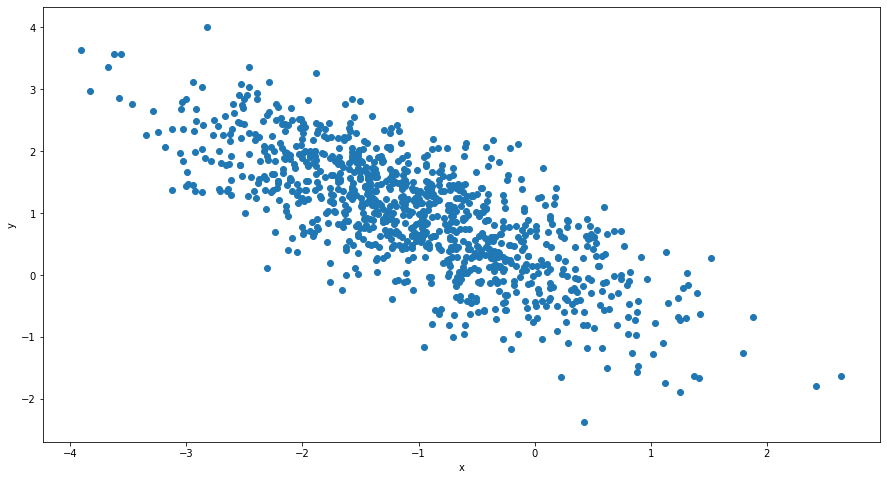

In [4]:
x, y = sample[:, 0], sample[:, 1]  # separate samples on feature x and target y

# Visualize dataset
plt.scatter(x, y)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [5]:
# Add singular bias feature
X = np.array([np.array([1, val]) for val in x])
X[:5], y[:5] # show X, y head

(array([[ 1.        , -1.23456697],
        [ 1.        , -1.41206346],
        [ 1.        ,  0.19923107],
        [ 1.        ,  0.07063588],
        [ 1.        ,  0.88191294]]),
 array([ 0.91683761,  0.48448888,  0.28675613,  1.72756281, -1.56377325]))

In [6]:
# check shapes
X.shape, y.shape

((1000, 2), (1000,))

# Define model

Prediction function $y = \theta^Tx$:

In [0]:
def predict(X, theta):
    return np.dot(X, theta)

Cost function as normalized sum of errors on the dataset: $J(\theta) = \frac{1}{2m} \sum_m(y-h_\theta(X))^2$

In [0]:
def computeCost(X, y, theta):
    return sum((y - predict(X, theta))**2) / (2*len(X))

Test for random weights:

In [9]:
theta = np.empty_like(X[0])
theta

array([1.        , 1.25276897])

Check shape

In [10]:
predict(X, theta).shape

(1000,)

In [11]:
computeCost(X, y, theta) # this number tells us nothing for now and can only be used to compare with future values

2.902226790236537

Visualize model's prediction:

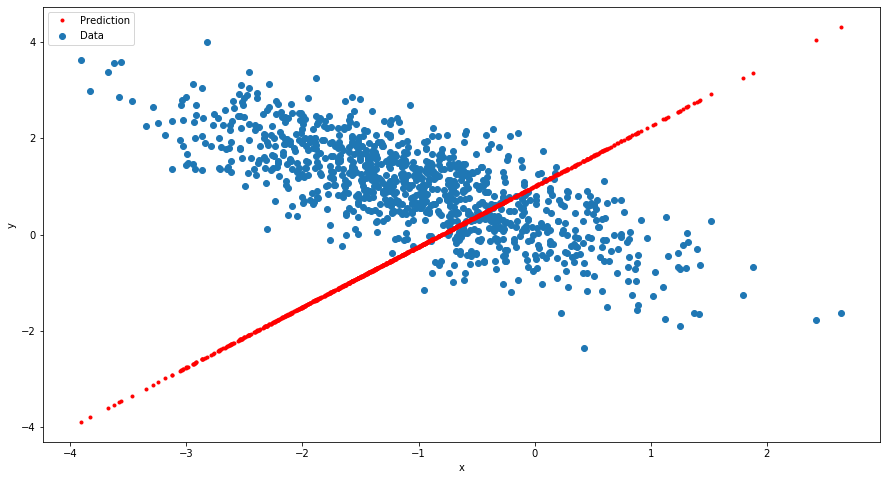

In [12]:
plt.scatter(x, y, label = 'Data')
plt.xlabel('x')
plt.ylabel('y')
plt.plot(x,predict(X,theta), 'r.', label = 'Prediction')
plt.legend()

Obviously two points should be enough to show all predictions of the linear model:

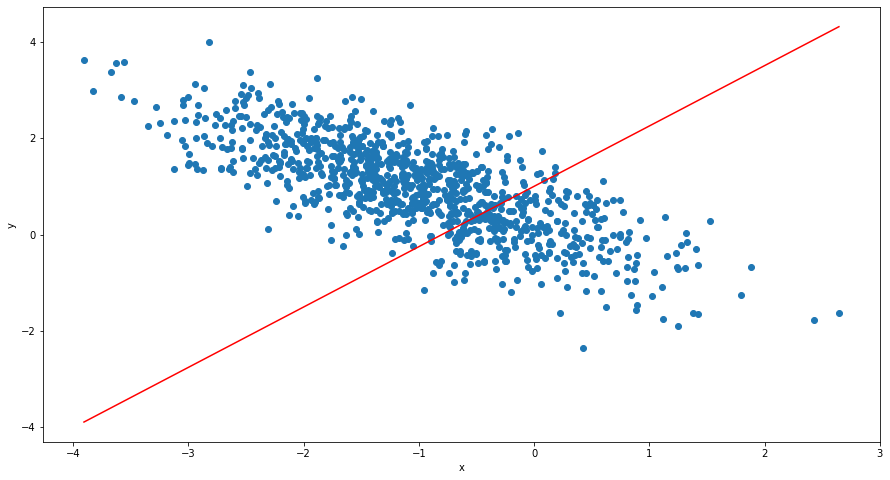

In [13]:
extremes = np.array([np.min(x), np.max(x)]) # edge points
line = theta[0] + extremes * theta[1] # prediction formula without adding singular column

plt.plot(extremes, line, 'r-')
plt.scatter(x, y)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

Let's visualize cost function surface in 3d space. For this compute cost function value for a grid-shaped set of $\theta$ values:

In [0]:
size = 100 # amount of tries for each parameter
limits = (-10,10) # range of values for each parameter
error = np.zeros((size,size)) # empty matrix of errors
for i,w in enumerate(np.linspace(*limits,size)): # for each theta[0] component
    for j,b in enumerate(np.linspace(*limits,size)): # for each theate[1] component
        error[i,j] = computeCost(X, y, np.array([b,w])) # compute cost for each theta

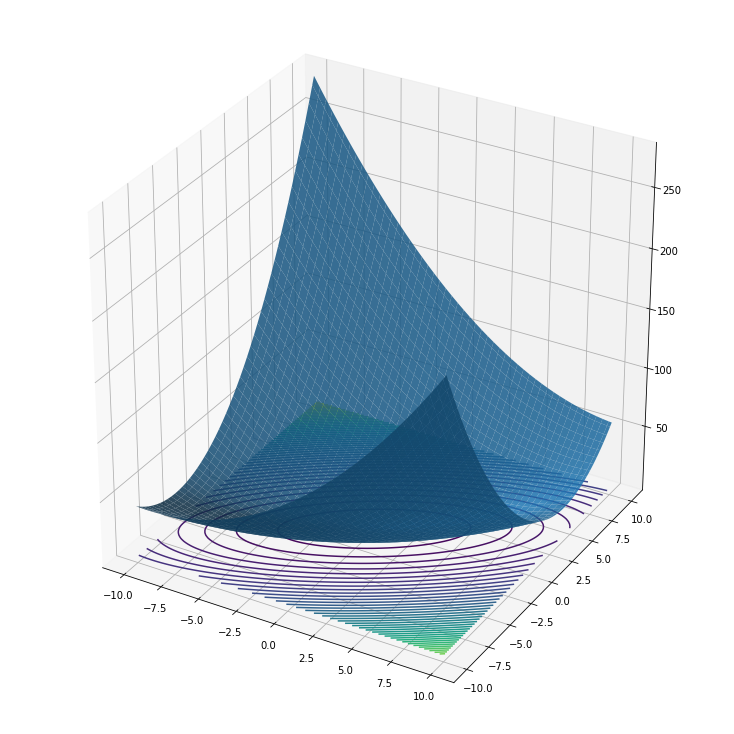

In [15]:
# initialize figure
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure(figsize = (10,10))
ax = Axes3D(fig)

# create 2d array for each index 
K,L = np.meshgrid(np.linspace(*limits,size),np.linspace(*limits,size))

ax.plot_surface(K,L,Z = error, alpha = 0.85) # plot cost function surface in 3d
plt.contour(K,L,error,50, offset = 0) # plot cost function 2d-projection

Observe, how changes in dataset impacts cost function surface.

# Learn model

### Define learning algorithm

Simple gradient descent algorithm: 

$\theta = \theta + \alpha \nabla J(\theta)$

$\nabla J(\theta) = \sum_m(y - h_\theta(X))X$

In [0]:
def gradientDescent(X, y, init = 1, alpha = 0.001, iters = 100):
    theta = np.ones_like(X[0]) * init # initialize theta with any scalar or vector
    m = len(X) 
    history = [] # list of theta values on each iteration 
    cost = [] # list of cost function values on each iteration
    
    for i in range(iters):
        history.append(theta)
        cost.append(computeCost(X, y, theta))
        
        theta = theta + alpha  * (np.sum((y - np.dot(X, theta.T)) * X.T, axis = 1)) # gradient descent itself, vectorized
    
    return theta, np.array(cost), np.array(history)

Initialize learning

In [0]:
alpha = 0.0001
iters = 100

Learn model

In [0]:
w, cost, history = gradientDescent(X, y, 
                                   alpha = alpha, 
                                   iters = iters, 
                                   init = [5,10]) # initialize with far point for better visualization

In [19]:
print("Model's cost: ", computeCost(X, y, w))
print("Calculated weights: ", w)

Model's cost:  0.21226453833163023
Calculated weights:  [ 0.43011944 -0.60601376]


Visualize model

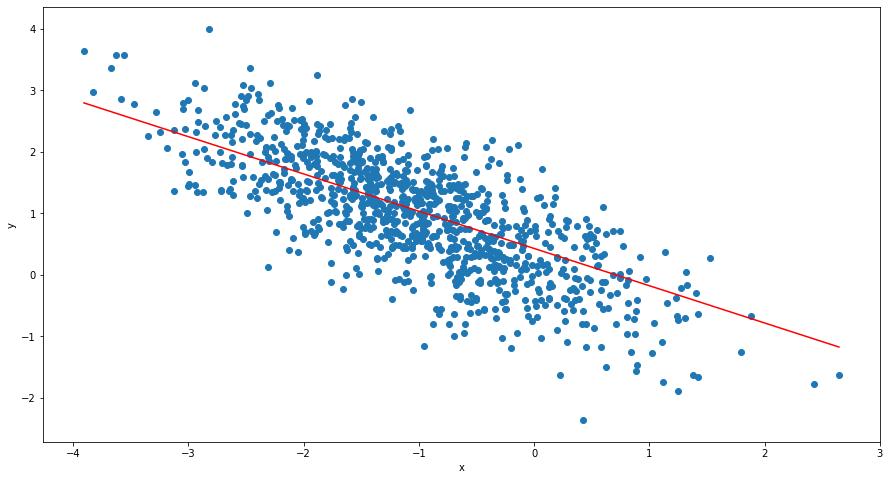

In [20]:
extremes = np.array([np.min(x), np.max(x)])
line = w[0] + extremes * w[1]
plt.plot(extremes, line, 'r-')
plt.scatter(x, y)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

### Visualize learning process

Cost function:

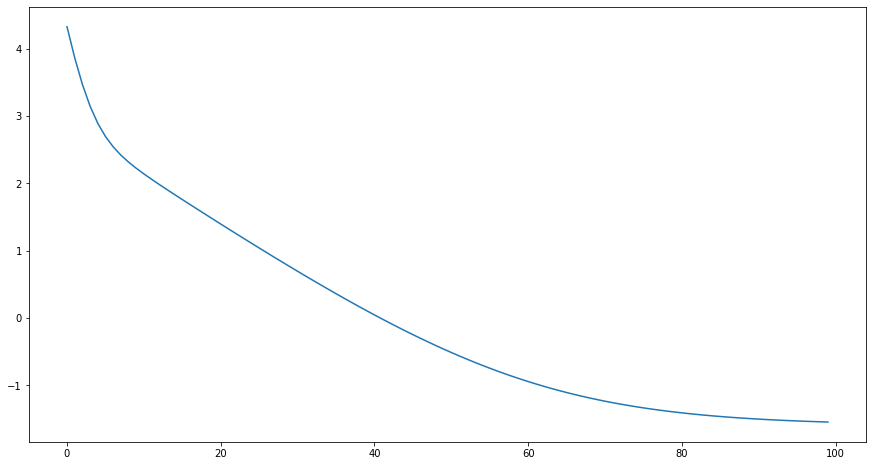

In [21]:
plt.plot(np.log(cost))

Model's trajectory in parameter's space

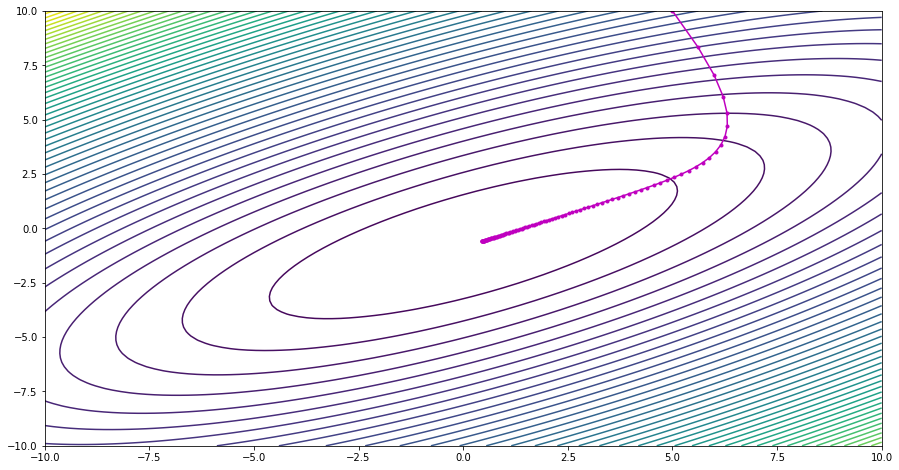

In [22]:
plt.contour(K,L,error,50)
plt.plot(history[:,0], history[:,1],'m.-')

Model's trajectory on cost function surface:

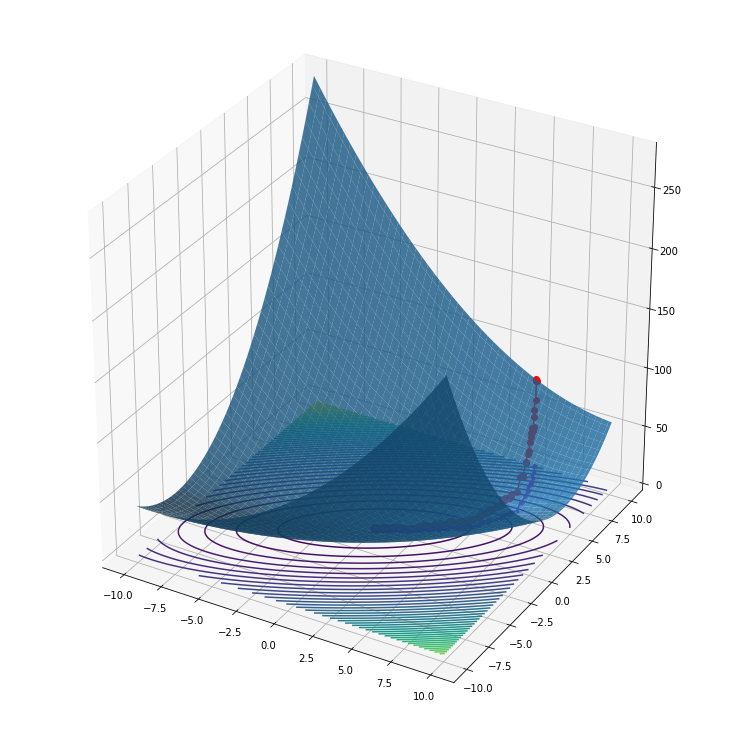

In [38]:
fig = plt.figure(figsize = (10,10))
ax = Axes3D(fig)
ax.plot_surface(K,L,Z = error, alpha = 0.8)
ax.plot3D(history[:,0], history[:,1], cost, 'ro-')
plt.contour(K,L,error,50, offset = 0)
plt.plot(history[:,0], history[:,1],'m.-')

#### Add stochastic mode for gradient descent:

In [0]:
def StochasticGD(X, y, alpha, iters, batch_size, init = 1):
    theta = np.ones_like(X[0]) * init
    # unnecessary variables for visualization purposes
    cost = []
    history = []
    data = [] # put batches here
    
    for i in range(iters):
        history.append(theta)
        cost.append(computeCost(X, y, theta))
        
        idx = np.random.choice(len(X), replace=False, size=batch_size) # choose random batch from dataset
        data.append((X[idx][:,1], y[idx]))
        theta, _, _ = gradientDescent(X[idx], y[idx], 
                                      alpha = alpha, 
                                      iters = 1, 
                                      init = theta)
    return theta, np.array(cost), np.array(history), np.array(data)

In [0]:
w, cost, history, data = StochasticGD(X, y, 
                                alpha = 0.01, 
                                iters = iters*10, 
                                batch_size = 2, 
                                init = [5,10])

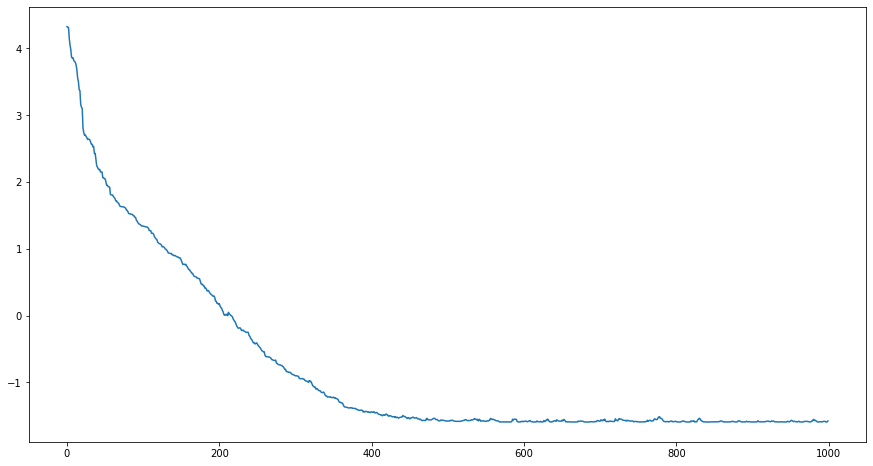

In [26]:
plt.plot(np.log(cost)) # often looks beter in log scale

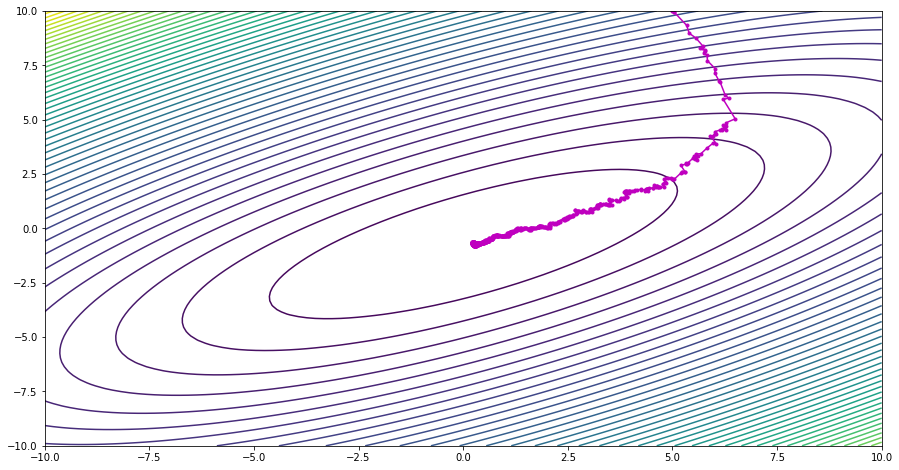

In [27]:
plt.contour(K,L,error,50)
plt.plot(history[:,0], history[:,1],'m.-')

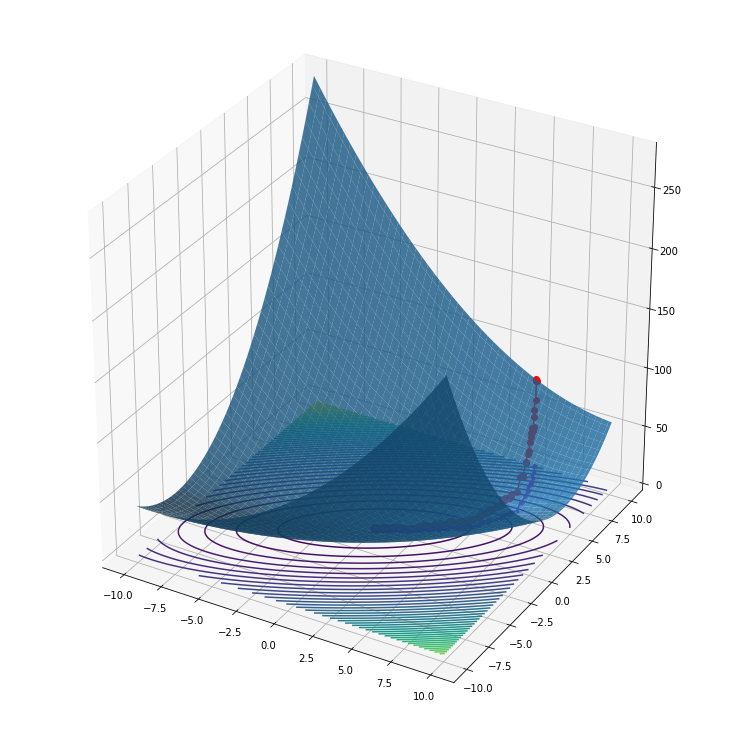

In [28]:
fig = plt.figure(figsize = (10,10))
ax = Axes3D(fig)
ax.plot_surface(K,L,Z = error, alpha = 0.8)
ax.plot3D(history[:,0], history[:,1], cost, 'ro-')
plt.contour(K,L,error,50, offset = 0)
plt.plot(history[:,0], history[:,1],'m.-')

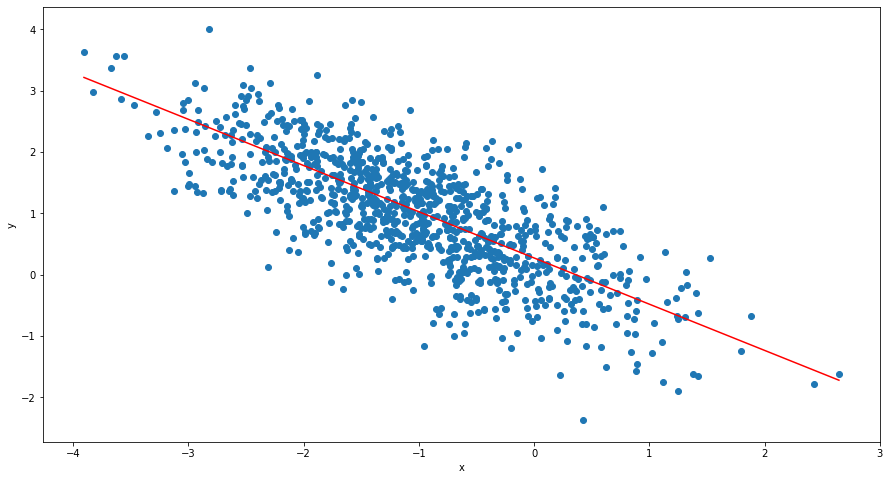

In [29]:
extremes = np.array([np.min(x), np.max(x)])
line =  w[0] + extremes * w[1]
plt.plot(extremes, line, 'r-')
plt.scatter(x, y)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

In [30]:
print("Model's cost: ", computeCost(X, y, w))
print("Calculated weights: ", w)

Model's cost:  0.20581516041580422
Calculated weights:  [ 0.27429917 -0.75332158]


##### Move it!

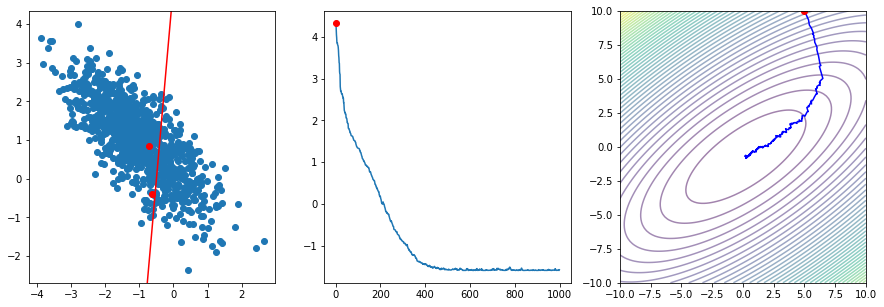

In [31]:
import matplotlib.animation
from IPython.display import HTML

plt.rcParams['animation.embed_limit'] = 50 # animation size limit in megabytes

extremes = np.array([np.min(x), np.max(x)]) # edge points for line

fig, (ax1, ax2, ax3) = plt.subplots(1,3, figsize = (15,5))

# stable data
ax1.scatter(x, y, label = 'Data') # data space
ax2.plot(np.log(cost)) # cost function
ax3.contour(K,L,error,50, alpha = 0.5) # parameters' space
ax3.plot(history[:,0], history[:,1],'b-') # model's trajectory

# animated data
l, = ax1.plot([],[], 'r-')
k, = ax2.plot([],[], 'ro')
m, = ax3.plot([],[], 'ro')
d, = ax1.plot([],[], 'ro')

def animate(i): # animation function is called on each frame
    l.set_data(extremes, history[i,0] + extremes * history[i,1]) # model position
    k.set_data(i, np.log(cost[i])) # cost fucntion value
    m.set_data(history[i,0], history[i,1]) # theta value
    d.set_data(data[i][0], data[i][1]) # observed samples

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=range(len(history))[::10]) # draw only each tenth position for speed

HTML(ani.to_jshtml())

##### Let's try sklearn implementation:

In [32]:
from sklearn import linear_model
model = linear_model.LinearRegression()
model.fit(X, y)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

Get a look to the model's coefficients and compare with obtained above:

In [33]:
model.coef_ # only theta[1:] here

array([ 0.        , -0.72145356])

In [34]:
model.intercept_ # theta[0] is called "intercept" in sklearn

0.2432840353605965

In [0]:
w = np.array([model.intercept_, model.coef_[1]]) # to visualize it in usual way

In [36]:
print("Model's cost: ", computeCost(X, y, w))
print("Calculated weights: ", w)

Model's cost:  0.20330426247952835
Calculated weights:  [ 0.24328404 -0.72145356]


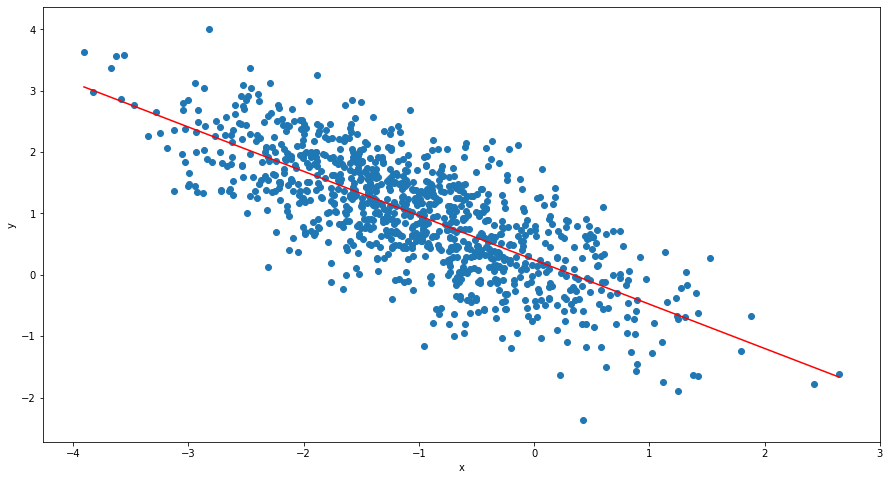

In [37]:
extremes = np.array([np.min(x), np.max(x)])
line =  w[0] + extremes * w[1]
plt.plot(extremes, line, 'r-')
plt.scatter(x, y)
plt.xlabel('x')
plt.ylabel('y')
plt.show()

There is no model's trajectory or learning process visualization because sklearn learns linear models in closed form, solving [normal equation](http://mlwiki.org/index.php/Normal_Equation).